<a href="https://colab.research.google.com/github/Processamento-de-video-UFABC-2021-2/Processamento-de-video-UFABC-2021-2.github.io/blob/main/relatorio_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import math as Math
from google.colab.patches import cv2_imshow # cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


Nessa primeira secção desenvolveremos algumas funções que servirão de utilitários ao decorrer do código.

In [ ]:
def openImageCv(fileName, param = "NULL"):
  # Caminho completo da imagem
  pathImage = '/content/drive/My Drive/processamento-de-video/' + fileName
  # Função 'imread' da biblioteca 'cv' para realizar a leitura da imagem à partir de seu arquivo

  if param == "NULL":
    return cv.imread(pathImage)

  return cv.imread(pathImage, param)

Para alterar o tamanho da imagem criamos uma função que recebe um fator de escala e muda a imagem mantendo suas proporções.

In [ ]:
def resizeImage(img, factor):
  sqrtFactor = Math.sqrt(factor)
  return cv.resize(img, None, fx=sqrtFactor, fy=sqrtFactor)


##a) Apresentem as imagens originais e as versões em P&B delas

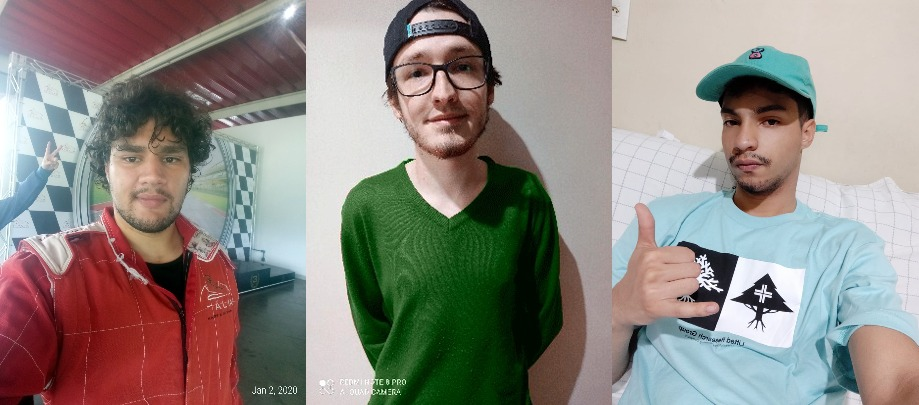

In [ ]:
#Exibição das imagem dos integrantes

imgIntegrante = openImageCv('grupo-rgb.jpg')
cv2_imshow(imgIntegrante)

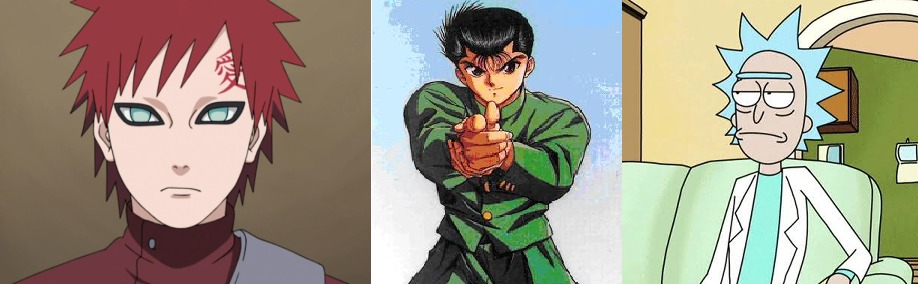

In [ ]:
#Apresentação dos Avatares
imgAvatar = openImageCv('grupo-avatar-rgb.jpg')
cv2_imshow(imgAvatar)


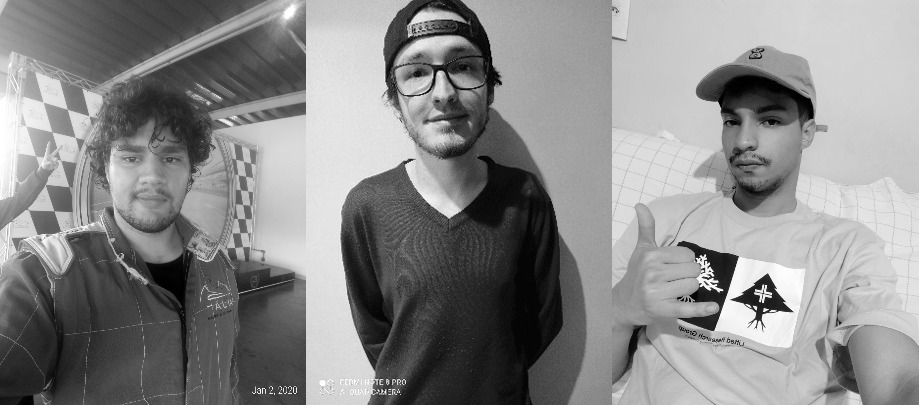

In [ ]:
# Exibição dos integrantes em Preto e Branco

imgIntegrante = openImageCv('grupo-rgb.jpg', cv.IMREAD_GRAYSCALE)
cv2_imshow(imgIntegrante)


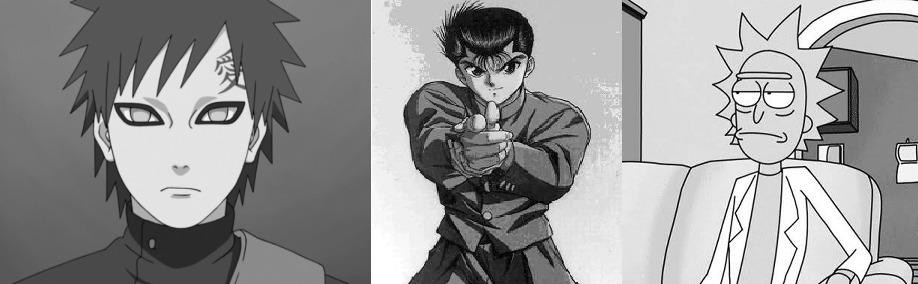

In [ ]:
# Exibição dos Avatares em Preto e Branco

imgAvatar = openImageCv('grupo-avatar-rgb.jpg', cv.IMREAD_GRAYSCALE)
cv2_imshow(imgAvatar)


##b) Apresentem as imagens com duas resoluções diferentes cada

Para o bloco de código abaixo, foram realizadas as seguintes ações, repetidas para cada imagem de integrante:

1. Realizada a leitura da imagem
2. Feito o primeiro 'resize' da imagem e display da mesma
3. Feito o segundo 'resize' e display, em outra resolução

A imagem original tem: 372195 pixels


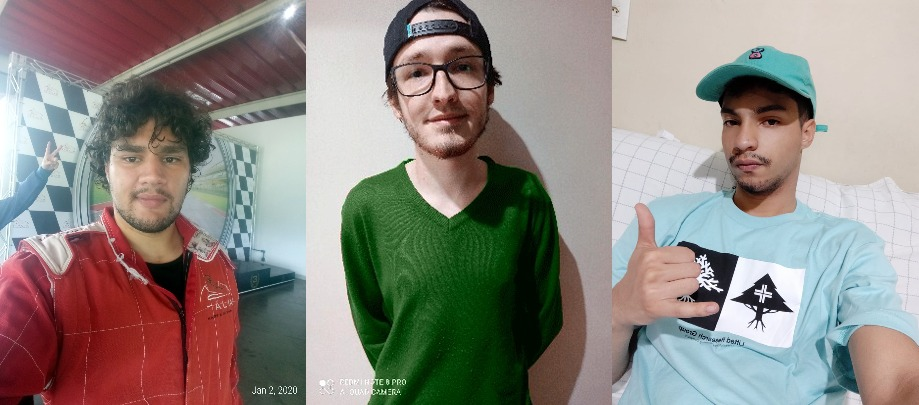


50% tem: 372195 pixels


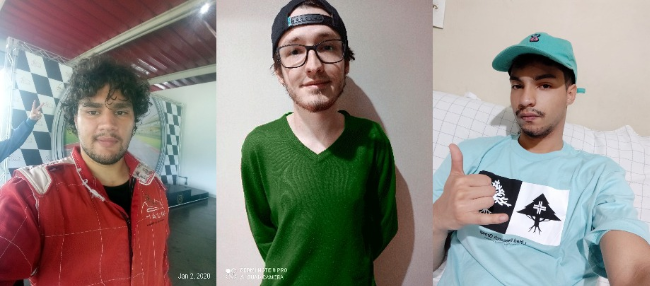


10% tem: 372195 pixels


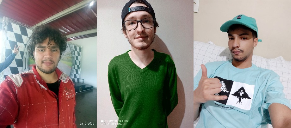

In [ ]:
imgIntegrante = openImageCv('grupo-rgb.jpg')
originalX, originalY, colors = imgIntegrante.shape

print('A imagem original tem: ' + str(originalX * originalY) + ' pixels')
cv2_imshow(imgIntegrante)

# show 50% 
img2 = resizeImage(imgIntegrante, 0.5)
halfX, halfY, colors = img2.shape
print('\n50% tem: ' + str(halfX * halfY) + ' pixels')
cv2_imshow(img2)

# show 10% 
img3 = resizeImage(imgIntegrante, 0.1)
decX, decY, colors = img3.shape
print('\n10% tem: ' + str(decX * decY) + ' pixels')
cv2_imshow(img3)



A imagem original tem: 260712 pixels


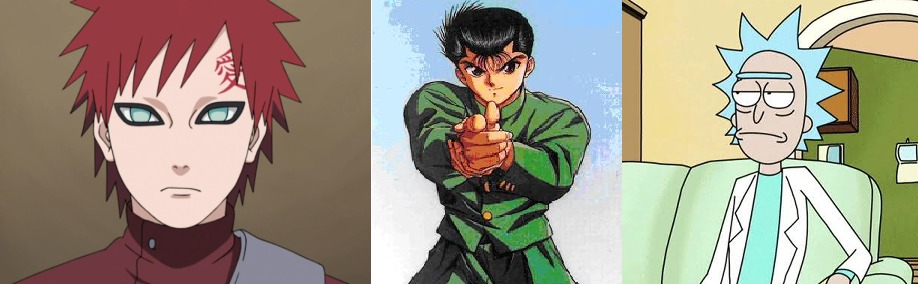


50% tem: 130449 pixels


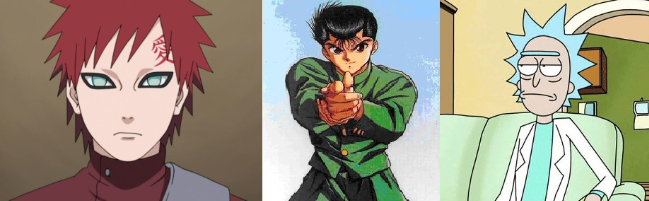


10% tem: 26100 pixels


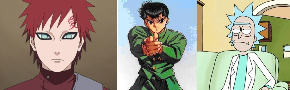

In [ ]:
imgAvatar = openImageCv('grupo-avatar-rgb.jpg')
originalX, originalY, colors = imgAvatar.shape

print('A imagem original tem: ' + str(originalX * originalY) + ' pixels')
cv2_imshow(imgAvatar)

# show 50% 
img2 = resizeImage(imgAvatar, 0.5)
halfX, halfY, colors = img2.shape
print('\n50% tem: ' + str(halfX * halfY) + ' pixels')
cv2_imshow(img2)

# show 10% 
img3 = resizeImage(imgAvatar, 0.1)
decX, decY, colors = img3.shape
print('\n10% tem: ' + str(decX * decY) + ' pixels')
cv2_imshow(img3)

**c) Apresentem os vídeos com mudança de resolução, 25% e 50% dos originais;**


A função getFrames abaixo recebe um vídeo e devolve uma lista de frames. 

In [ ]:
def getFrames(video):
  frames = []
  while True:
    ret, frame = video.read()
    if ret == True:
       frames.append(frame)
    else:
        break

  return frames



Os trechos de código abaixo pegam os frames desmontados redimenciona os mesmos e remontam o vídeo. 

In [ ]:
#video rapido 50%
videoRapidoPath = '/content/drive/My Drive/processamento-de-video/video1.mp4'
videoRapido = cv.VideoCapture(videoRapidoPath)

fourcc = cv.VideoWriter_fourcc(*'XVID')

out = cv.VideoWriter('/content/drive/My Drive/processamento-de-video/outputRapido50.avi',fourcc, 60.0, (249, 453))

while True:
    ret, frame = videoRapido.read()
    if ret == True:
      newFrame = resizeImage(frame, 0.5)
      sizeFrameX , sizeFrameY, colors = newFrame.shape
      out.write(newFrame)
    else:
      break

videoRapido.release()

# print(out)
out.release()

In [ ]:
#video rapido 25%
videoRapidoPath = '/content/drive/My Drive/processamento-de-video/video1.mp4'
videoRapido = cv.VideoCapture(videoRapidoPath)

frames = getFrames(videoRapido)

sizeFrameX , sizeFrameY, colors = frames[0].shape

fourcc = cv.VideoWriter_fourcc('M','J','P','G')
output = cv.VideoWriter('/content/drive/My Drive/processamento-de-video/outputRapido25.mp4',fourcc, 60, (sizeFrameX,sizeFrameY))

for frame in frames:
  newFrame = resizeImage(frame, 0.25)
  output.write(newFrame)

videoRapido.release()
output.release()
cv.destroyAllWindows()

In [ ]:
#video Lento 50%
videoLentoPath = '/content/drive/My Drive/processamento-de-video/video2.mp4'
videoLento = cv.VideoCapture(videoLentoPath)

frames = getFrames(videoLento)

sizeFrameX , sizeFrameY, colors = frames[0].shape

fourcc = cv.VideoWriter_fourcc('M','J','P','G')
output = cv.VideoWriter('/content/drive/My Drive/processamento-de-video/outputLento50.mp4',fourcc, 60, (sizeFrameX,sizeFrameY))

for frame in frames:
  newFrame = resizeImage(frame, 0.5)
  output.write(newFrame)

videoLento.release()
output.release()
cv.destroyAllWindows()

In [ ]:
#video Lento 25%
videoLentoPath = '/content/drive/My Drive/processamento-de-video/video2.mp4'
videoLento = cv.VideoCapture(videoLentoPath)

frames = getFrames(videoLento)

sizeFrameX , sizeFrameY, colors = frames[0].shape

fourcc = cv.VideoWriter_fourcc('M','J','P','G')
output = cv.VideoWriter('/content/drive/My Drive/processamento-de-video/outputLento25.mp4',fourcc, 60, (sizeFrameX,sizeFrameY))

for frame in frames:
  newFrame = resizeImage(frame, 0.25)
  output.write(newFrame)

videoLento.release()
output.release()
cv.destroyAllWindows()

O trecho a baixo é para a apresentação dos vídeos acima. 



In [ ]:
from IPython.display import HTML
from base64 import b64encode

videoRapidoOriginalPath = '/content/drive/My Drive/processamento-de-video/video1.mp4'
videoRapido50Path = '/content/drive/My Drive/processamento-de-video/outputRapido50.mp4'
videoRapido25Path = '/content/drive/My Drive/processamento-de-video/outputRapido25.mp4'


videoLentoOriginalPath = '/content/drive/My Drive/processamento-de-video/video2.mp4'
videoLento50Path = '/content/drive/My Drive/processamento-de-video/outputLento50.mp4'
videoLento25Path = '/content/drive/My Drive/processamento-de-video/outputLento25.mp4'


# Armazenamento da leitura do conteúdo do arquivo mp4
mp4RapidoOriginal = open(videoRapidoOriginalPath,'rb').read()
mp4Rapido50 = open(videoRapido50Path,'rb').read()
mp4Rapido25 = open(videoRapido25Path,'rb').read()

mp4LentoOriginal = open(videoLentoOriginalPath,'rb').read()
mp4Lento50 = open(videoLento50Path,'rb').read()
mp4Lento25 = open(videoLento25Path,'rb').read()

# Decodificar conteúdo do víeo
videoDecodedRapidoOriginal = "data:video/mp4;base64," + b64encode(mp4RapidoOriginal).decode()
videoDecodedRapido50 = "data:video/mp4;base64," + b64encode(mp4Rapido50).decode()
videoDecodedRapido25 = "data:video/mp4;base64," + b64encode(mp4Rapido25).decode()

videoDecodedLentoOriginal = "data:video/mp4;base64," + b64encode(mp4LentoOriginal).decode()
videoDecodedLento50 = "data:video/mp4;base64," + b64encode(mp4Lento50).decode()
videoDecodedLento25 = "data:video/mp4;base64," + b64encode(mp4Lento25).decode()

HTML(f'<p>Original</p><video width={352} height={640} controls><source src= {videoDecodedRapidoOriginal} type="video/mp4">')
HTML(f'<p>50%</p><video width={352} height={640} controls><source src= {videoDecodedRapido50} type="video/mp4">')
# f'<p>25%</p><video width={352} height={640} controls><source src= {videoDecodedRapido25} type="video/mp4">'

# # Vetor para armazenar o código HTML referente ao vídeo e sua resolução
# videoValues = []

# # Função para obtenção de vídeos em diferentes resoluções
# def videoElements(fileName, alias, halfWidth, halfHeight, oneFourthWidth, oneFourthHeight):
#   # Caminho completo da imagem
#   videoPath = '/content/drive/My Drive/processamento-de-video/' + fileName
#   # Armazenamento da leitura do conteúdo do arquivo mp4
#   mp4 = open(videoPath,'rb').read()
#   # Decodificar conteúdo do víeo
#   videoDecoded = "data:video/mp4;base64," + b64encode(mp4).decode()
#   # Adiciona o conteúdo do HTML para a lista videoValues em resoluções originais, 50% e 25% respectivamente
#   videoValues.append(f'<p>{alias} - Original</p><video controls><source src= {videoDecoded} type="video/mp4">')
#   videoValues.append(f'<p>{alias} - 50%</p><video width={halfWidth} height={halfHeight} controls><source src= {videoDecoded} type="video/mp4">')
#   videoValues.append(f'<p>{alias} - 25%</p><video width={oneFourthWidth} height={oneFourthHeight} controls><source src= {videoDecoded} type="video/mp4">')

# # Execução da função para o video1
# videoElements('video1.mp4', 'Movimento rápido', 176, 320, 88, 160)
# # Execução da função para o vídeo2
# videoElements('video2.mp4', 'Movimento lento', 176, 320, 88, 160)


Como a função HTML do GoogleColab aceita apenas um elemento de vídeo, abaixo serão exibidos os vídeos e suas resoluções separadamente.

In [ ]:
HTML(f'<p>Original</p><video width={704} height={640} controls><source src= {videoDecodedRapidoOriginal} type="video/mp4">')

In [ ]:
HTML(f'<p>50%</p><video width={352} height={640} controls><source src= {videoDecodedRapido50} type="video/mp4">')

In [ ]:
HTML(f'<p>25%</p><video width={352} height={640} controls><source src= {videoDecodedRapido25} type="video/mp4">')

In [ ]:
# Vídeo Rápido - 50%
HTML(f'{videoValues[1]}')

In [ ]:
# Vídeo Rápido - 25%
HTML(f'{videoValues[2]}')

In [ ]:
# Vídeo Lento - Original
HTML(f'{videoValues[3]}')

In [ ]:
# Vídeo Lento - 50%
HTML(f'{videoValues[4]}')

In [ ]:
# Vídeo Lento - 25%
HTML(f'{videoValues[5]}')